In [1]:
import json
import csv
import pandas as pd
import numpy as np
import plotly.express as px

In [15]:
full_df = pd.read_excel('Online-Retail.xlsx')

In [16]:
full_df.head()

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850.0,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850.0,United Kingdom
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom


In [17]:
UK_df = full_df[full_df['Country'] == "United Kingdom"]


In [18]:
UK_df

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850.0,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850.0,United Kingdom
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom
...,...,...,...,...,...,...,...,...
541889,581585,22466,FAIRY TALE COTTAGE NIGHT LIGHT,12,2011-12-09 12:31:00,1.95,15804.0,United Kingdom
541890,581586,22061,LARGE CAKE STAND HANGING STRAWBERY,8,2011-12-09 12:49:00,2.95,13113.0,United Kingdom
541891,581586,23275,SET OF 3 HANGING OWLS OLLIE BEAK,24,2011-12-09 12:49:00,1.25,13113.0,United Kingdom
541892,581586,21217,RED RETROSPOT ROUND CAKE TINS,24,2011-12-09 12:49:00,8.95,13113.0,United Kingdom


In [19]:
UK_df['Description'] = UK_df['Description'].str.strip()

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [20]:
UK_df.dropna(axis = 0, subset =['InvoiceNo'], inplace = True) 
UK_df['InvoiceNo'] = UK_df['InvoiceNo'].astype('str')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [21]:
UK_df = UK_df[~UK_df['InvoiceNo'].str.contains('C')] 


In [24]:
# df = UK_df.groupby('Description').nunique()
df = UK_df['Description'].unique()

In [27]:
Description_series = UK_df['Description']

In [31]:
Description_series = Description_series.reset_index()

In [34]:
Item_count = Description_series.groupby('Description').count()

In [41]:
Items = Item_count.sort_values(by='index', ascending=False)

In [44]:
top_100_items = Items.head(100)

In [11]:
purchases = UK_df['InvoiceNo'].nunique()

In [53]:
top_100items = top_100_items.rename(columns= {"index":"Number of purchases"})

In [56]:
top_100items.to_csv('top_purchased_items.csv')

In [57]:
UK_df.head()

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850.0,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850.0,United Kingdom
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom


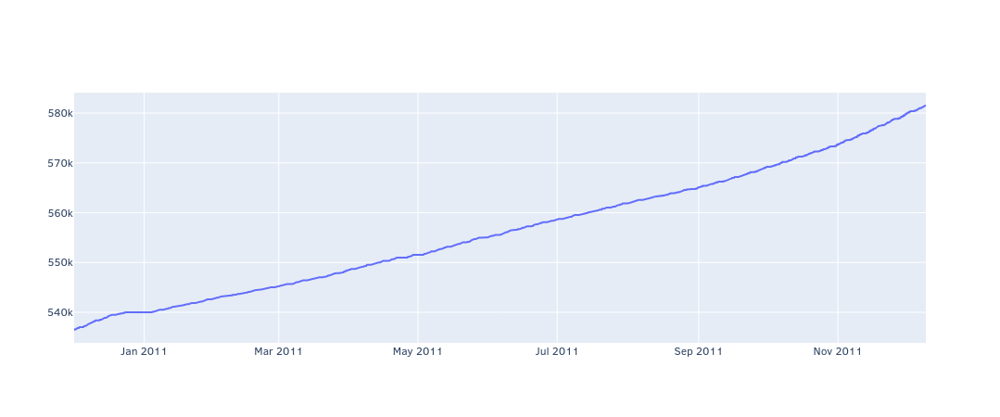

In [67]:
fig = go.Figure([go.Scatter(x=UK_df['InvoiceDate'], y=UK_df['InvoiceNo'])])
fig.show()

In [80]:
to_graph = UK_df.groupby('InvoiceDate').count()

In [81]:
to_graph = to_graph.reset_index()

In [82]:
to_graph

,InvoiceDate,InvoiceNo,StockCode,Description,Quantity,UnitPrice,CustomerID,Country
0,2010-12-01 08:26:00,7,7,7,7,7,7,7
1,2010-12-01 08:28:00,2,2,2,2,2,2,2
2,2010-12-01 08:34:00,16,16,16,16,16,16,16
3,2010-12-01 08:35:00,1,1,1,1,1,1,1
4,2010-12-01 09:00:00,1,1,1,1,1,1,1
...,...,...,...,...,...,...,...,...
18300,2011-12-09 12:21:00,2,2,2,2,2,2,2
18301,2011-12-09 12:23:00,2,2,2,2,2,2,2
18302,2011-12-09 12:25:00,2,2,2,2,2,2,2
18303,2011-12-09 12:31:00,21,21,21,21,21,21,21


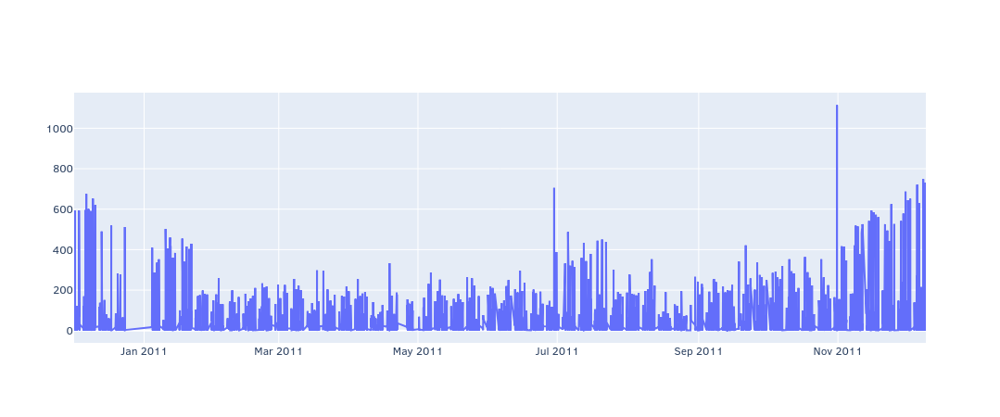

In [83]:
fig = go.Figure([go.Scatter(x=to_graph['InvoiceDate'], y=to_graph['InvoiceNo'])])
fig.show()

In [85]:
graph_time = to_graph[['InvoiceDate', 'InvoiceNo']]

In [87]:
graph_time.to_csv('purchases_2011.csv')

In [65]:
import plotly.graph_objects as go


In [89]:
peak = UK_df.head(10)

In [90]:
peak.to_csv('UK_peek.csv')

In [20]:
top_purch_items = df1.head(50)


In [ ]:
cust = UK_df.groupby('CustomerID')['InvoiceNo'].nunique()

In [ ]:
result = pd.read_csv('1_(sup=0.02, conf=0.03).csv')